<div class="markdown-google-sans">
  <h1>Welcome to Colab!</h1>
</div>

<div class="markdown-google-sans">
  <h2>&#40;New&#41; Try the Gemini API</h2>
  <ul>
  <li><a href="https://makersuite.google.com/app/apikey">Generate a Gemini API key</a></li>
  <li><a href="https://colab.research.google.com/github/googlecolab/colabtools/blob/main/notebooks/Talk_to_Gemini_with_Google%27s_Speech_to_Text_API.ipynb?utm_medium=link&utm_campaign=gemini">Talk to Gemini with the Speech-to-Text API</a></li>
  <li><a href="https://colab.research.google.com/github/google/generative-ai-docs/blob/main/site/en/tutorials/quickstart_colab.ipynb?utm_medium=link&utm_campaign=gemini">Gemini API: Quickstart with Python</a></li>
  <li><a href="https://colab.research.google.com/notebooks/snippets/gemini.ipynb?utm_medium=link&utm_campaign=gemini">Gemini API code sample</a></li>
  <li><a href="https://colab.research.google.com/github/googlecolab/colabtools/blob/main/notebooks/Learning_with_Gemini_and_ChatGPT.ipynb?utm_medium=link&utm_campaign=gemini">Compare Gemini with ChatGPT</a></li>  
  <li><a href="https://colab.google/notebooks/?utm_medium=link&utm_campaign=gemini">More notebooks</a></li>
  </ul>
</div>


If you're already familiar with Colab, check out this video to learn about interactive tables, the executed code history view and the command palette.

<center>
  <a href="https://www.youtube.com/watch?v=rNgswRZ2C1Y" target="_blank">
  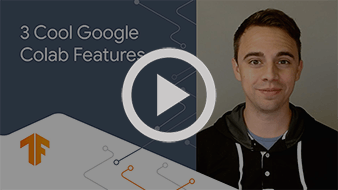
  </a>
</center>

In [2]:
import pandas as pd
df=pd.read_csv("owid-covid-data.csv")

In [3]:
df.head()

,iso_code,continent,location,date,total_cases,new_cases,new_cases_smoothed,total_deaths,new_deaths,new_deaths_smoothed,...,male_smokers,handwashing_facilities,hospital_beds_per_thousand,life_expectancy,human_development_index,population,excess_mortality_cumulative_absolute,excess_mortality_cumulative,excess_mortality,excess_mortality_cumulative_per_million
0,AFG,Asia,Afghanistan,2020-01-05,0.0,0.0,NaN,0.0,0.0,NaN,...,NaN,37.746,0.5,64.83,0.511,41128772,NaN,NaN,NaN,NaN
1,AFG,Asia,Afghanistan,2020-01-06,0.0,0.0,NaN,0.0,0.0,NaN,...,NaN,37.746,0.5,64.83,0.511,41128772,NaN,NaN,NaN,NaN
2,AFG,Asia,Afghanistan,2020-01-07,0.0,0.0,NaN,0.0,0.0,NaN,...,NaN,37.746,0.5,64.83,0.511,41128772,NaN,NaN,NaN,NaN
3,AFG,Asia,Afghanistan,2020-01-08,0.0,0.0,NaN,0.0,0.0,NaN,...,NaN,37.746,0.5,64.83,0.511,41128772,NaN,NaN,NaN,NaN
4,AFG,Asia,Afghanistan,2020-01-09,0.0,0.0,NaN,0.0,0.0,NaN,...,NaN,37.746,0.5,64.83,0.511,41128772,NaN,NaN,NaN,NaN


In [4]:
df.columns

Index(['iso_code', 'continent', 'location', 'date', 'total_cases', 'new_cases',
       'new_cases_smoothed', 'total_deaths', 'new_deaths',
       'new_deaths_smoothed', 'total_cases_per_million',
       'new_cases_per_million', 'new_cases_smoothed_per_million',
       'total_deaths_per_million', 'new_deaths_per_million',
       'new_deaths_smoothed_per_million', 'reproduction_rate', 'icu_patients',
       'icu_patients_per_million', 'hosp_patients',
       'hosp_patients_per_million', 'weekly_icu_admissions',
       'weekly_icu_admissions_per_million', 'weekly_hosp_admissions',
       'weekly_hosp_admissions_per_million', 'total_tests', 'new_tests',
       'total_tests_per_thousand', 'new_tests_per_thousand',
       'new_tests_smoothed', 'new_tests_smoothed_per_thousand',
       'positive_rate', 'tests_per_case', 'tests_units', 'total_vaccinations',
       'people_vaccinated', 'people_fully_vaccinated', 'total_boosters',
       'new_vaccinations', 'new_vaccinations_smoothed',
       't

In [5]:
df.isnull().sum()

iso_code                                        0
continent                                   26525
location                                        0
date                                            0
total_cases                                 17631
                                            ...  
population                                      0
excess_mortality_cumulative_absolute       416024
excess_mortality_cumulative                416024
excess_mortality                           416024
excess_mortality_cumulative_per_million    416024
Length: 67, dtype: int64

In [6]:
df.shape

(429435, 67)

In [7]:
df.drop(columns=["excess_mortality_cumulative_per_million","excess_mortality","excess_mortality_cumulative",
"excess_mortality_cumulative_absolute"], inplace=True)

In [8]:
df.isnull().sum()

iso_code                           0
continent                      26525
location                           0
date                               0
total_cases                    17631
                               ...  
handwashing_facilities        267694
hospital_beds_per_thousand    138746
life_expectancy                39136
human_development_index       110308
population                         0
Length: 63, dtype: int64

In [9]:
import plotly.express as px

In [10]:
px.box(df["total_cases"]) #keine outlyer

In [11]:
#handling missing werts
df["total_cases"]=df['total_cases'].fillna(df["total_cases"].median())

In [12]:
px.box(df["life_expectancy"]) # outlayer

In [13]:
df["life_expectancy"]=df['life_expectancy'].fillna(df["life_expectancy"].median())

In [14]:
df["new_cases_smoothed"]=df['new_cases_smoothed'].fillna(df["new_cases_smoothed"].mean())

In [15]:
df["new_deaths_smoothed"]=df['new_deaths_smoothed'].fillna(df["new_deaths_smoothed"].mean())

In [16]:
df["new_cases"]=df['new_cases'].fillna(df["new_cases"].mean())

In [17]:
df["extreme_poverty"]=df['extreme_poverty'].fillna(df["extreme_poverty"].mean())

In [18]:
df["female_smokers"]=df['female_smokers'].fillna(df["female_smokers"].mean())

In [19]:
df["male_smokers"]=df['male_smokers'].fillna(df["male_smokers"].mean())

In [20]:
df["handwashing_facilities"]=df['handwashing_facilities'].fillna(df["handwashing_facilities"].mean())

In [21]:
df["hospital_beds_per_thousand"]=df['hospital_beds_per_thousand'].fillna(df["hospital_beds_per_thousand"].mean())

In [22]:
df["human_development_index"]=df['human_development_index'].fillna(df["human_development_index"].mean())

In [23]:
# Fill missing values with mode (most frequent value)
df['continent'].fillna(df['continent'].mode()[0], inplace=True)

C:\Users\fhenn\AppData\Local\Temp\ipykernel_19372\3714968871.py:2: FutureWarning:

A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.





**Alternative**
sklearn *biblothek*

In [24]:
#wir verwenden,wenn wir einmal fill wert statt missing wert wellen

In [25]:
from sklearn.impute import SimpleImputer

# Identify categorical & numerical columns
categorical_cols = df.select_dtypes(include=['object']).columns
numerical_cols = df.select_dtypes(include=['number']).columns

# Fill categorical columns with Mode (Most Frequent Value)
for col in categorical_cols:
    df[col].fillna(df[col].mode()[0], inplace=True)

# Fill numerical columns with Median
for col in numerical_cols:
    df[col].fillna(df[col].median(), inplace=True)

# Fill missing values in time-series data using Forward Fill
df.fillna(method='ffill', inplace=True)




ModuleNotFoundError: No module named 'sklearn'

In [ ]:
df.isnull().sum() #keine mehr null wert

,0
iso_code,0
continent,0
location,0
date,0
total_cases,0
...,...
handwashing_facilities,267694
hospital_beds_per_thousand,138746
life_expectancy,0
human_development_index,110308


In [ ]:
country = "United States"
df_country = df[df['location'] == country] # Filter Data by Country

In [ ]:
df_country

,iso_code,continent,location,date,total_cases,new_cases,new_cases_smoothed,total_deaths,new_deaths,new_deaths_smoothed,...,extreme_poverty,cardiovasc_death_rate,diabetes_prevalence,female_smokers,male_smokers,handwashing_facilities,hospital_beds_per_thousand,life_expectancy,human_development_index,population
403451,USA,North America,United States,2020-01-05,0.0,0.000000,8041.025775,0.0,0.0,72.060873,...,1.2,151.089,10.79,19.1,24.6,NaN,2.77,78.86,0.926,338289856
403452,USA,North America,United States,2020-01-06,0.0,0.000000,8041.025775,0.0,0.0,72.060873,...,1.2,151.089,10.79,19.1,24.6,NaN,2.77,78.86,0.926,338289856
403453,USA,North America,United States,2020-01-07,0.0,0.000000,8041.025775,0.0,0.0,72.060873,...,1.2,151.089,10.79,19.1,24.6,NaN,2.77,78.86,0.926,338289856
403454,USA,North America,United States,2020-01-08,0.0,0.000000,8041.025775,0.0,0.0,72.060873,...,1.2,151.089,10.79,19.1,24.6,NaN,2.77,78.86,0.926,338289856
403455,USA,North America,United States,2020-01-09,0.0,0.000000,8041.025775,0.0,0.0,72.060873,...,1.2,151.089,10.79,19.1,24.6,NaN,2.77,78.86,0.926,338289856
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
405120,USA,North America,United States,2024-07-31,103436829.0,8017.359934,8041.025775,1192546.0,0.0,88.429000,...,1.2,151.089,10.79,19.1,24.6,NaN,2.77,78.86,0.926,338289856
405121,USA,North America,United States,2024-08-01,103436829.0,8017.359934,8041.025775,1192546.0,0.0,88.429000,...,1.2,151.089,10.79,19.1,24.6,NaN,2.77,78.86,0.926,338289856
405122,USA,North America,United States,2024-08-02,103436829.0,8017.359934,8041.025775,1192546.0,0.0,88.429000,...,1.2,151.089,10.79,19.1,24.6,NaN,2.77,78.86,0.926,338289856
405123,USA,North America,United States,2024-08-03,103436829.0,8017.359934,8041.025775,1192546.0,0.0,88.429000,...,1.2,151.089,10.79,19.1,24.6,NaN,2.77,78.86,0.926,338289856


In [ ]:
df1=df.copy()

In [ ]:
import pandas as pd

# Ensure 'date' is in datetime format
df['date'] = pd.to_datetime(df['date'])

# Extract only the day from the date
df['day'] = df['date'].dt.day  #convertieren date auf tag

# Display the updated DataFrame
print(df[['date', 'day']].head())


        date  day
0 2020-01-05    5
1 2020-01-06    6
2 2020-01-07    7
3 2020-01-08    8
4 2020-01-09    9


In [ ]:
df.head()

,iso_code,continent,location,date,total_cases,new_cases,new_cases_smoothed,total_deaths,new_deaths,new_deaths_smoothed,...,cardiovasc_death_rate,diabetes_prevalence,female_smokers,male_smokers,handwashing_facilities,hospital_beds_per_thousand,life_expectancy,human_development_index,population,day
0,AFG,Asia,Afghanistan,2020-01-05,0.0,0.0,8041.025775,0.0,0.0,72.060873,...,597.029,9.59,10.772465,33.097723,37.746,0.5,64.83,0.511,41128772,5
1,AFG,Asia,Afghanistan,2020-01-06,0.0,0.0,8041.025775,0.0,0.0,72.060873,...,597.029,9.59,10.772465,33.097723,37.746,0.5,64.83,0.511,41128772,6
2,AFG,Asia,Afghanistan,2020-01-07,0.0,0.0,8041.025775,0.0,0.0,72.060873,...,597.029,9.59,10.772465,33.097723,37.746,0.5,64.83,0.511,41128772,7
3,AFG,Asia,Afghanistan,2020-01-08,0.0,0.0,8041.025775,0.0,0.0,72.060873,...,597.029,9.59,10.772465,33.097723,37.746,0.5,64.83,0.511,41128772,8
4,AFG,Asia,Afghanistan,2020-01-09,0.0,0.0,8041.025775,0.0,0.0,72.060873,...,597.029,9.59,10.772465,33.097723,37.746,0.5,64.83,0.511,41128772,9


In [ ]:
df_new_cases = df[df['new_cases'] > 0]

In [ ]:
print(df_new_cases[['date', 'location', 'new_cases']].head(100)) #taglish new case


          date     location  new_cases
56  2020-03-01  Afghanistan        1.0
70  2020-03-15  Afghanistan        6.0
77  2020-03-22  Afghanistan       17.0
84  2020-03-29  Afghanistan       67.0
91  2020-04-05  Afghanistan      183.0
..         ...          ...        ...
728 2022-01-02  Afghanistan      210.0
735 2022-01-09  Afghanistan      233.0
742 2022-01-16  Afghanistan      333.0
749 2022-01-23  Afghanistan      870.0
756 2022-01-30  Afghanistan     2118.0

[100 rows x 3 columns]


In [ ]:
df_new_cases = df[df['new_deaths'] > 0]
print(df_new_cases[['date', 'location', 'new_deaths']].head(100))

          date     location  new_deaths
84  2020-03-29  Afghanistan         2.0
91  2020-04-05  Afghanistan         3.0
98  2020-04-12  Afghanistan        10.0
105 2020-04-19  Afghanistan        15.0
112 2020-04-26  Afghanistan        13.0
..         ...          ...         ...
756 2022-01-30  Afghanistan        17.0
763 2022-02-06  Afghanistan        18.0
770 2022-02-13  Afghanistan        63.0
777 2022-02-20  Afghanistan        46.0
784 2022-02-27  Afghanistan        54.0

[100 rows x 3 columns]


In [ ]:
country = "United States"
df_usa_cases = df[(df['location'] == country) & (df['new_cases'] > 0)]

print(df_usa_cases[['date', 'new_cases']].head(20))


             date  new_cases
403472 2020-01-26        7.0
403479 2020-02-02        2.0
403486 2020-02-09       11.0
403493 2020-02-16        4.0
403500 2020-02-23       16.0
403507 2020-03-01       33.0
403514 2020-03-08      391.0
403521 2020-03-15     3465.0
403528 2020-03-22    27486.0
403535 2020-03-29    94894.0
403542 2020-04-05   176151.0
403549 2020-04-12   219172.0
403556 2020-04-19   196150.0
403563 2020-04-26   205165.0
403570 2020-05-03   198436.0
403577 2020-05-10   182246.0
403584 2020-05-17   169032.0
403591 2020-05-24   166325.0
403598 2020-05-31   146436.0
403605 2020-06-07   149780.0


In [ ]:
country = "Afghanistan"
df_afg_cases= df[(df['location'] == country) & (df['new_deaths'] > 0)]

print(df_afg_cases[['date','new_deaths']].head(20))


          date  new_deaths
84  2020-03-29         2.0
91  2020-04-05         3.0
98  2020-04-12        10.0
105 2020-04-19        15.0
112 2020-04-26        13.0
119 2020-05-03        21.0
126 2020-05-10        41.0
133 2020-05-17        48.0
140 2020-05-24        58.0
147 2020-05-31        37.0
154 2020-06-07        79.0
161 2020-06-14       124.0
168 2020-06-21        97.0
175 2020-06-28       155.0
182 2020-07-05       123.0
189 2020-07-12       149.0
196 2020-07-19       172.0
203 2020-07-26        99.0
210 2020-08-02        37.0
217 2020-08-09        24.0


In [ ]:
df2=df.copy()

In [ ]:
start_date = "2020-01-05"
end_date = "2022-02-01"

df_date_range = df2[(df2['date'] >= start_date) & (df2['date'] <= end_date)]
print(df_date_range[['date', 'location', 'new_cases']])


             date     location  new_cases
0      2020-01-05  Afghanistan        0.0
1      2020-01-06  Afghanistan        0.0
2      2020-01-07  Afghanistan        0.0
3      2020-01-08  Afghanistan        0.0
4      2020-01-09  Afghanistan        0.0
...           ...          ...        ...
428515 2022-01-28     Zimbabwe        0.0
428516 2022-01-29     Zimbabwe        0.0
428517 2022-01-30     Zimbabwe     1236.0
428518 2022-01-31     Zimbabwe        0.0
428519 2022-02-01     Zimbabwe        0.0

[194413 rows x 3 columns]


In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 429435 entries, 2020-01-05 to 2024-08-04
Data columns (total 62 columns):
 #   Column                                      Non-Null Count   Dtype  
---  ------                                      --------------   -----  
 0   iso_code                                    429435 non-null  object 
 1   continent                                   429435 non-null  object 
 2   location                                    429435 non-null  object 
 3   total_cases                                 429435 non-null  float64
 4   new_cases                                   429435 non-null  float64
 5   new_cases_smoothed                          429435 non-null  float64
 6   total_deaths                                411804 non-null  float64
 7   new_deaths                                  410608 non-null  float64
 8   new_deaths_smoothed                         429435 non-null  float64
 9   total_cases_per_million                     411804 non

In [ ]:
for col in df.columns:
  print(df[col].value_counts())
  print("----------")

iso_code
OWID_HIC    3026
OWID_EUN    3024
OWID_UMC    3013
OWID_LMC    2983
OWID_LIC    2724
            ... 
OWID_SCT    1305
OWID_WLS    1198
MAC          795
OWID_CYN     691
ESH            1
Name: count, Length: 255, dtype: int64
----------
continent
Africa           121944
Europe            91031
Asia              84199
North America     68638
Oceania           40183
South America     23440
Name: count, dtype: int64
----------
location
High-income countries            3026
European Union (27)              3024
Upper-middle-income countries    3013
Lower-middle-income countries    2983
Low-income countries             2724
                                 ... 
Scotland                         1305
Wales                            1198
Macao                             795
Northern Cyprus                   691
Western Sahara                      1
Name: count, Length: 255, dtype: int64
----------
date
2022-01-10    261
2021-03-12    261
2021-03-14    261
2021-03-15    261
2021-03-1

In [ ]:
df[df['aged_65_older']>2.822]

,iso_code,continent,location,date,total_cases,new_cases,new_cases_smoothed,total_deaths,new_deaths,new_deaths_smoothed,...,cardiovasc_death_rate,diabetes_prevalence,female_smokers,male_smokers,handwashing_facilities,hospital_beds_per_thousand,life_expectancy,human_development_index,population,day
3348,ALB,Europe,Albania,2020-01-05,0.0,0.0,8041.025775,0.0,0.0,72.060873,...,304.195,10.08,7.1,51.2,NaN,2.89,78.57,0.795,2842318,5
3349,ALB,Europe,Albania,2020-01-06,0.0,0.0,8041.025775,0.0,0.0,72.060873,...,304.195,10.08,7.1,51.2,NaN,2.89,78.57,0.795,2842318,6
3350,ALB,Europe,Albania,2020-01-07,0.0,0.0,8041.025775,0.0,0.0,72.060873,...,304.195,10.08,7.1,51.2,NaN,2.89,78.57,0.795,2842318,7
3351,ALB,Europe,Albania,2020-01-08,0.0,0.0,8041.025775,0.0,0.0,72.060873,...,304.195,10.08,7.1,51.2,NaN,2.89,78.57,0.795,2842318,8
3352,ALB,Europe,Albania,2020-01-09,0.0,0.0,8041.025775,0.0,0.0,72.060873,...,304.195,10.08,7.1,51.2,NaN,2.89,78.57,0.795,2842318,9
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
426082,YEM,Asia,Yemen,2024-07-31,11945.0,0.0,0.000000,2159.0,0.0,0.000000,...,495.003,5.35,7.6,29.2,49.542,0.70,66.12,0.470,33696612,31
426083,YEM,Asia,Yemen,2024-08-01,11945.0,0.0,0.000000,2159.0,0.0,0.000000,...,495.003,5.35,7.6,29.2,49.542,0.70,66.12,0.470,33696612,1
426084,YEM,Asia,Yemen,2024-08-02,11945.0,0.0,0.000000,2159.0,0.0,0.000000,...,495.003,5.35,7.6,29.2,49.542,0.70,66.12,0.470,33696612,2
426085,YEM,Asia,Yemen,2024-08-03,11945.0,0.0,0.000000,2159.0,0.0,0.000000,...,495.003,5.35,7.6,29.2,49.542,0.70,66.12,0.470,33696612,3


In [ ]:
df[df['life_expectancy']>61.49] #filter by life_exectancy

,iso_code,continent,location,date,total_cases,new_cases,new_cases_smoothed,total_deaths,new_deaths,new_deaths_smoothed,...,cardiovasc_death_rate,diabetes_prevalence,female_smokers,male_smokers,handwashing_facilities,hospital_beds_per_thousand,life_expectancy,human_development_index,population,day
0,AFG,Asia,Afghanistan,2020-01-05,0.0,0.0,8041.025775,0.0,0.0,72.060873,...,597.029,9.59,10.772465,33.097723,37.746,0.5,64.83,0.511,41128772,5
1,AFG,Asia,Afghanistan,2020-01-06,0.0,0.0,8041.025775,0.0,0.0,72.060873,...,597.029,9.59,10.772465,33.097723,37.746,0.5,64.83,0.511,41128772,6
2,AFG,Asia,Afghanistan,2020-01-07,0.0,0.0,8041.025775,0.0,0.0,72.060873,...,597.029,9.59,10.772465,33.097723,37.746,0.5,64.83,0.511,41128772,7
3,AFG,Asia,Afghanistan,2020-01-08,0.0,0.0,8041.025775,0.0,0.0,72.060873,...,597.029,9.59,10.772465,33.097723,37.746,0.5,64.83,0.511,41128772,8
4,AFG,Asia,Afghanistan,2020-01-09,0.0,0.0,8041.025775,0.0,0.0,72.060873,...,597.029,9.59,10.772465,33.097723,37.746,0.5,64.83,0.511,41128772,9
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
427756,ZMB,Africa,Zambia,2024-07-31,349824.0,0.0,7.857000,4077.0,0.0,0.000000,...,234.499,3.94,3.100000,24.700000,13.938,2.0,63.89,0.584,20017670,31
427757,ZMB,Africa,Zambia,2024-08-01,349824.0,0.0,7.857000,4077.0,0.0,0.000000,...,234.499,3.94,3.100000,24.700000,13.938,2.0,63.89,0.584,20017670,1
427758,ZMB,Africa,Zambia,2024-08-02,349824.0,0.0,7.857000,4077.0,0.0,0.000000,...,234.499,3.94,3.100000,24.700000,13.938,2.0,63.89,0.584,20017670,2
427759,ZMB,Africa,Zambia,2024-08-03,349824.0,0.0,7.857000,4077.0,0.0,0.000000,...,234.499,3.94,3.100000,24.700000,13.938,2.0,63.89,0.584,20017670,3


In [ ]:
df1=df.copy()

In [ ]:
country = "United States"
df_country1 = df1[df1['location'] == country]

In [ ]:
import pandas as pd

# Ensure 'date' is in datetime format
df_country1['date'] = pd.to_datetime(df_country1['date'])

# Set 'date' as index for resampling to work
df_country1.set_index('date', inplace=True)

# Resample: Aggregate new cases weekly & monthly
df_country_weekly = df_country1.resample('W').sum()
df_country_monthly = df_country1.resample('M').sum()

# Display results
print(df_country_weekly.head())



                         iso_code  \
date                                
2020-01-05                    USA   
2020-01-12  USAUSAUSAUSAUSAUSAUSA   
2020-01-19  USAUSAUSAUSAUSAUSAUSA   
2020-01-26  USAUSAUSAUSAUSAUSAUSA   
2020-02-02  USAUSAUSAUSAUSAUSAUSA   

                                                    continent  \
date                                                            
2020-01-05                                      North America   
2020-01-12  North AmericaNorth AmericaNorth AmericaNorth A...   
2020-01-19  North AmericaNorth AmericaNorth AmericaNorth A...   
2020-01-26  North AmericaNorth AmericaNorth AmericaNorth A...   
2020-02-02  North AmericaNorth AmericaNorth AmericaNorth A...   

                                                     location  total_cases  \
date                                                                         
2020-01-05                                      United States          0.0   
2020-01-12  United StatesUnited StatesUnited State

<ipython-input-67-33291c132d14>:4: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-67-33291c132d14>:11: FutureWarning:

'M' is deprecated and will be removed in a future version, please use 'ME' instead.



In [ ]:
print(df_country_monthly.head())

                                                     iso_code  \
date                                                            
2020-01-31  USAUSAUSAUSAUSAUSAUSAUSAUSAUSAUSAUSAUSAUSAUSAU...   
2020-02-29  USAUSAUSAUSAUSAUSAUSAUSAUSAUSAUSAUSAUSAUSAUSAU...   
2020-03-31  USAUSAUSAUSAUSAUSAUSAUSAUSAUSAUSAUSAUSAUSAUSAU...   
2020-04-30  USAUSAUSAUSAUSAUSAUSAUSAUSAUSAUSAUSAUSAUSAUSAU...   
2020-05-31  USAUSAUSAUSAUSAUSAUSAUSAUSAUSAUSAUSAUSAUSAUSAU...   

                                                    continent  \
date                                                            
2020-01-31  North AmericaNorth AmericaNorth AmericaNorth A...   
2020-02-29  North AmericaNorth AmericaNorth AmericaNorth A...   
2020-03-31  North AmericaNorth AmericaNorth AmericaNorth A...   
2020-04-30  North AmericaNorth AmericaNorth AmericaNorth A...   
2020-05-31  North AmericaNorth AmericaNorth AmericaNorth A...   

                                                     location  total_cases  \
date      

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 429435 entries, 0 to 429434
Data columns (total 64 columns):
 #   Column                                      Non-Null Count   Dtype         
---  ------                                      --------------   -----         
 0   iso_code                                    429435 non-null  object        
 1   continent                                   429435 non-null  object        
 2   location                                    429435 non-null  object        
 3   date                                        429435 non-null  datetime64[ns]
 4   total_cases                                 429435 non-null  float64       
 5   new_cases                                   429435 non-null  float64       
 6   new_cases_smoothed                          429435 non-null  float64       
 7   total_deaths                                411804 non-null  float64       
 8   new_deaths                                  410608 non-null  float64      

In [ ]:
df["new_cases"].corr(df["female_smokers"])

-0.0007755938112832706


What Does This Correlation Value Mean?
#Correlation ranges from -1 to +1:
+1 → Strong positive correlation (both increase together)
0 → No correlation (no relationship)
-1 → Strong negative correlation (one increases, the other decreases)
Your result: -0.00077

Very close to 0, meaning there is almost no relationship between the percentage of female smokers and the number of new COVID-19 cases.
A negative value means that, if any relationship exists, more female smokers might slightly correlate with fewer cases—but this is extremely weak.



In [ ]:
df_country = df_country.set_index('date') #set "date" column as the index
df_country['daily_growth_rate'] = df_country['new_cases'].pct_change() * 100  # Percentage change
df_country['weekly_growth_rate'] = df_country['new_cases'].resample('W').sum().pct_change() * 100 #calculate weekly growth

df_country.head(100)

KeyError: "None of ['date'] are in the columns"



*   
*  # pct_change() calculates the percentage change between the current and previous day's new cases.
* 100 converts it to a percentage.
💡 Example:
Date	New Cases	Daily Growth Rate
.2024-01-01	100	NaN (No previous day)
.2024-01-02	120	(120 - 100) / 100 * 100 = 20%
.2024-01-03	90	(90 - 120) / 120 * 100 = -25%



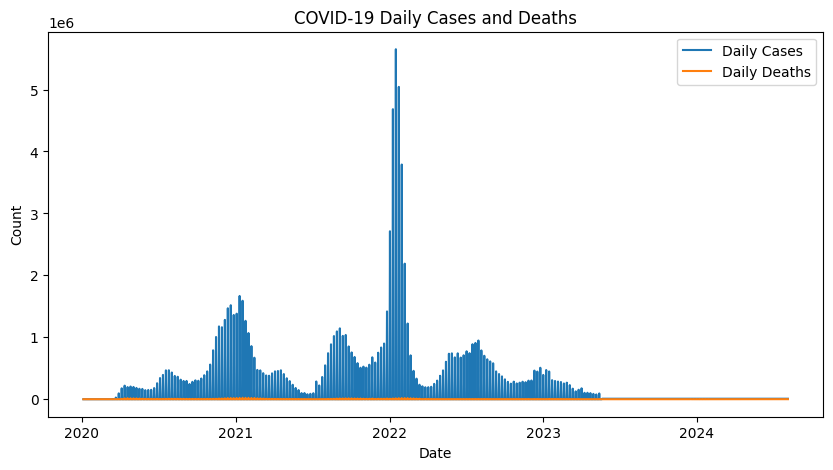

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

plt.figure(figsize=(10,5))
sns.lineplot(x=df_country.index, y=df_country['new_cases'], label="Daily Cases")
sns.lineplot(x=df_country.index, y=df_country['new_deaths'], label="Daily Deaths")
plt.title("COVID-19 Daily Cases and Deaths")
plt.xlabel("Date")
plt.ylabel("Count")
plt.legend()
plt.show()


In [ ]:
import plotly.express as px

fig = px.line(df_country, x=df_country.index, y=['new_cases', 'new_deaths'], title="COVID-19 Cases & Deaths Over Time")
fig.show()


<Axes: xlabel='new_cases', ylabel='new_deaths'>

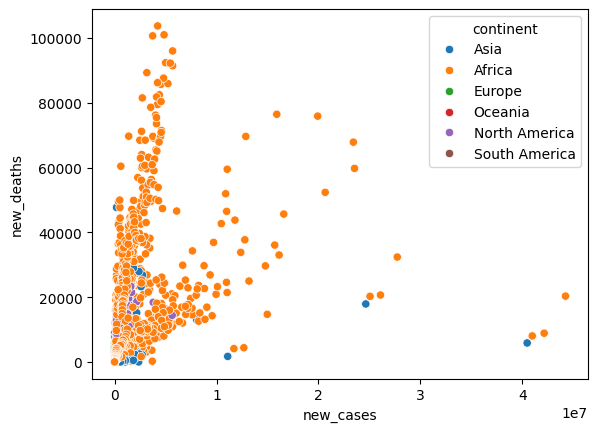

In [ ]:
# num-numerical .new_cases vs new_deaths
sns.scatterplot(x=df["new_cases"],y=df["new_deaths"],hue=df["continent"])

<Axes: xlabel='location', ylabel='continent'>

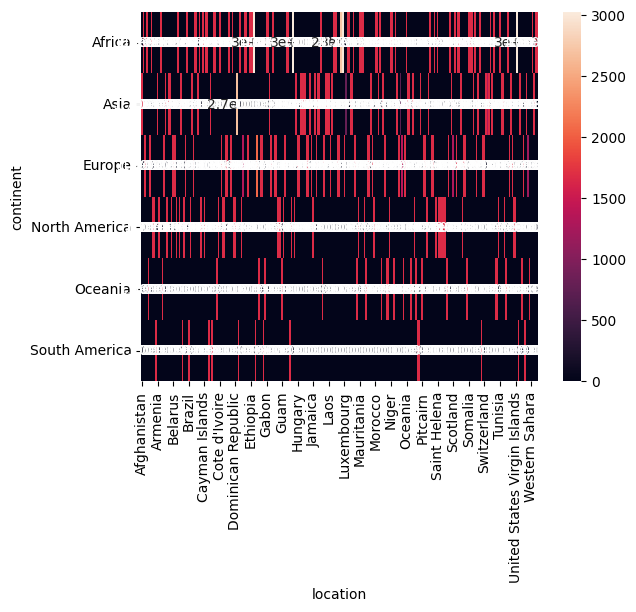

In [ ]:
# cat-cat
# continent,location
import pandas as pd
sns.heatmap(pd.crosstab(df["continent"],df["location"]),annot=True)

<div class="markdown-google-sans">
  <h2>What is Colab?</h2>
</div>

Colab, or ‘Colaboratory’, allows you to write and execute Python in your browser, with
- Zero configuration required
- Access to GPUs free of charge
- Easy sharing

Whether you're a <strong>student</strong>, a <strong>data scientist</strong> or an <strong>AI researcher</strong>, Colab can make your work easier. Watch <a href="https://www.youtube.com/watch?v=inN8seMm7UI">Introduction to Colab</a> to find out more, or just get started below!

<div class="markdown-google-sans">

## <strong>Getting started</strong>
</div>

The document that you are reading is not a static web page, but an interactive environment called a <strong>Colab notebook</strong> that lets you write and execute code.

For example, here is a <strong>code cell</strong> with a short Python script that computes a value, stores it in a variable and prints the result:

In [ ]:
seconds_in_a_day = 24 * 60 * 60
seconds_in_a_day

86400

To execute the code in the above cell, select it with a click and then either press the play button to the left of the code, or use the keyboard shortcut 'Command/Ctrl+Enter'. To edit the code, just click the cell and start editing.

Variables that you define in one cell can later be used in other cells:

In [ ]:
seconds_in_a_week = 7 * seconds_in_a_day
seconds_in_a_week

604800

Colab notebooks allow you to combine <strong>executable code</strong> and <strong>rich text</strong> in a single document, along with <strong>images</strong>, <strong>HTML</strong>, <strong>LaTeX</strong> and more. When you create your own Colab notebooks, they are stored in your Google Drive account. You can easily share your Colab notebooks with co-workers or friends, allowing them to comment on your notebooks or even edit them. To find out more, see <a href="/notebooks/basic_features_overview.ipynb">Overview of Colab</a>. To create a new Colab notebook you can use the File menu above, or use the following link: <a href="http://colab.research.google.com#create=true">Create a new Colab notebook</a>.

Colab notebooks are Jupyter notebooks that are hosted by Colab. To find out more about the Jupyter project, see <a href="https://www.jupyter.org">jupyter.org</a>.

<div class="markdown-google-sans">

## Data science
</div>

With Colab you can harness the full power of popular Python libraries to analyse and visualise data. The code cell below uses <strong>numpy</strong> to generate some random data, and uses <strong>matplotlib</strong> to visualise it. To edit the code, just click the cell and start editing.

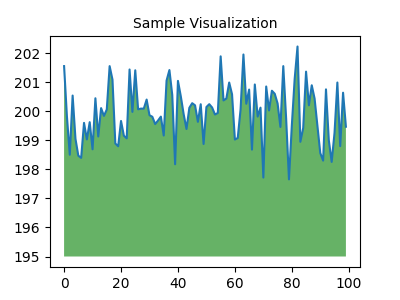

In [ ]:
import numpy as np
import IPython.display as display
from matplotlib import pyplot as plt
import io
import base64

ys = 200 + np.random.randn(100)
x = [x for x in range(len(ys))]

fig = plt.figure(figsize=(4, 3), facecolor='w')
plt.plot(x, ys, '-')
plt.fill_between(x, ys, 195, where=(ys > 195), facecolor='g', alpha=0.6)
plt.title("Sample Visualization", fontsize=10)

data = io.BytesIO()
plt.savefig(data)
image = F"data:image/png;base64,{base64.b64encode(data.getvalue()).decode()}"
alt = "Sample Visualization"
display.display(display.Markdown(F"""![{alt}]({image})"""))
plt.close(fig)

You can import your own data into Colab notebooks from your Google Drive account, including from spreadsheets, as well as from GitHub and many other sources. To find out more about importing data, and how Colab can be used for data science, see the links below under <a href="#working-with-data">Working with data</a>.

<div class="markdown-google-sans">

## Machine learning
</div>

With Colab you can import an image dataset, train an image classifier on it, and evaluate the model, all in just <a href="https://colab.research.google.com/github/tensorflow/docs/blob/master/site/en/tutorials/quickstart/beginner.ipynb">a few lines of code</a>. Colab notebooks execute code on Google's cloud servers, meaning you can leverage the power of Google hardware, including <a href="#using-accelerated-hardware">GPUs and TPUs</a>, regardless of the power of your machine. All you need is a browser.

Colab is used extensively in the machine learning community with applications including:
- Getting started with TensorFlow
- Developing and training neural networks
- Experimenting with TPUs
- Disseminating AI research
- Creating tutorials

To see sample Colab notebooks that demonstrate machine learning applications, see the <a href="#machine-learning-examples">machine learning examples</a> below.

<div class="markdown-google-sans">

## More resources

### Working with notebooks in Colab

</div>

- [Overview of Colaboratory](/notebooks/basic_features_overview.ipynb)
- [Guide to markdown](/notebooks/markdown_guide.ipynb)
- [Importing libraries and installing dependencies](/notebooks/snippets/importing_libraries.ipynb)
- [Saving and loading notebooks in GitHub](https://colab.research.google.com/github/googlecolab/colabtools/blob/main/notebooks/colab-github-demo.ipynb)
- [Interactive forms](/notebooks/forms.ipynb)
- [Interactive widgets](/notebooks/widgets.ipynb)

<div class="markdown-google-sans">

<a name="working-with-data"></a>
### Working with data
</div>

- [Loading data: Drive, Sheets and Google Cloud Storage](/notebooks/io.ipynb)
- [Charts: visualising data](/notebooks/charts.ipynb)
- [Getting started with BigQuery](/notebooks/bigquery.ipynb)

<div class="markdown-google-sans">

### Machine learning crash course

<div>

These are a few of the notebooks from Google's online machine learning course. See the <a href="https://developers.google.com/machine-learning/crash-course/">full course website</a> for more.
- [Intro to Pandas DataFrame](https://colab.research.google.com/github/google/eng-edu/blob/main/ml/cc/exercises/pandas_dataframe_ultraquick_tutorial.ipynb)
- [Linear regression with tf.keras using synthetic data](https://colab.research.google.com/github/google/eng-edu/blob/main/ml/cc/exercises/linear_regression_with_synthetic_data.ipynb)

<div class="markdown-google-sans">

<a name="using-accelerated-hardware"></a>
### Using accelerated hardware
</div>

- [TensorFlow with GPUs](/notebooks/gpu.ipynb)
- [TensorFlow with TPUs](/notebooks/tpu.ipynb)

<div class="markdown-google-sans">

<a name="machine-learning-examples"></a>

### Featured examples

</div>

- <a href="https://colab.research.google.com/github/NVIDIA/NeMo/blob/stable/tutorials/VoiceSwapSample.ipynb">NeMo voice swap</a>: Use Nvidia NeMo conversational AI toolkit to swap a voice in an audio fragment with a computer-generated one.

- <a href="https://tensorflow.org/hub/tutorials/tf2_image_retraining">Retraining an Image Classifier</a>: Build a Keras model on top of a pre-trained image classifier to distinguish flowers.
- <a href="https://tensorflow.org/hub/tutorials/tf2_text_classification">Text Classification</a>: Classify IMDB film reviews as either <em>positive</em> or <em>negative</em>.
- <a href="https://tensorflow.org/hub/tutorials/tf2_arbitrary_image_stylization">Style Transfer</a>: Use deep learning to transfer style between images.
- <a href="https://tensorflow.org/hub/tutorials/retrieval_with_tf_hub_universal_encoder_qa">Multilingual Universal Sentence Encoder Q&amp;A</a>: Use a machine-learning model to answer questions from the SQuAD dataset.
- <a href="https://tensorflow.org/hub/tutorials/tweening_conv3d">Video Interpolation</a>: Predict what happened in a video between the first and the last frame.
